<a href="https://colab.research.google.com/github/AgustinMoralejo/TRABAJO_PRACTICO_1-Organizacion_de_datos/blob/main/TRABAJO_PRACTICO_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# importacion general de librerias y de visualizacion (matplotlib y seaborn)
import pandas as pd
import numpy as np
import random as rd
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

plt.style.use('default') # haciendo los graficos un poco mas bonitos en matplotlib

sns.set(style="whitegrid") # seteando tipo de grid en seaborn

pd.options.display.float_format = '{:20,.2f}'.format # suprimimos la notacion cientifica en los outputs

import warnings
warnings.filterwarnings('ignore')

#--------------------------------------------------------------------------------------------------------

from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials


#--------------------------------------------------------------------------------------------------------

auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)


In [ ]:
from google.colab import files
files.upload()

Saving train_values.csv to train_values.csv
Saving train_labels.csv to train_labels.csv


{'train_labels.csv': b'building_id,damage_grade\n802906,3\n28830,2\n94947,3\n590882,2\n201944,3\n333020,2\n728451,3\n475515,1\n441126,2\n989500,1\n7962,3\n452227,2\n444381,2\n287845,3\n605134,3\n563431,2\n633759,2\n980230,3\n354011,2\n483543,3\n793397,2\n433870,2\n219578,2\n933368,2\n519606,2\n801078,3\n973909,2\n858160,2\n466558,2\n529366,3\n406413,2\n16485,2\n157370,2\n119565,2\n141871,3\n903120,3\n864809,1\n252816,3\n33651,3\n90130,2\n306024,2\n677028,2\n833827,3\n180267,2\n1005736,2\n440102,1\n132583,2\n362494,2\n987864,3\n402996,1\n871517,2\n877361,2\n605460,2\n288541,1\n893477,3\n135600,3\n987565,3\n552720,2\n624119,3\n302199,2\n961851,2\n1044113,2\n270811,2\n767109,3\n415067,2\n439999,2\n799678,2\n648002,2\n388581,3\n612701,3\n591993,3\n708530,2\n645774,3\n907445,2\n483230,2\n1041381,2\n425720,1\n426951,2\n732884,2\n206961,3\n529881,2\n118711,2\n965807,3\n928851,2\n603867,3\n67684,3\n361363,2\n645772,3\n931198,2\n250898,3\n351011,2\n852077,3\n262843,2\n311370,3\n722503,3\n551423

In [ ]:
df_train_labels = pd.read_csv('train_labels.csv')
df_train_values = pd.read_csv('train_values.csv')

In [ ]:
df_train_labels.head()

,building_id,damage_grade
0,802906,3
1,28830,2
2,94947,3
3,590882,2
4,201944,3


In [ ]:
df_train_values.head()

,building_id,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,land_surface_condition,foundation_type,roof_type,ground_floor_type,other_floor_type,position,plan_configuration,has_superstructure_adobe_mud,has_superstructure_mud_mortar_stone,has_superstructure_stone_flag,has_superstructure_cement_mortar_stone,has_superstructure_mud_mortar_brick,has_superstructure_cement_mortar_brick,has_superstructure_timber,has_superstructure_bamboo,has_superstructure_rc_non_engineered,has_superstructure_rc_engineered,has_superstructure_other,legal_ownership_status,count_families,has_secondary_use,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other
0,802906,6,487,12198,2,30,6,5,t,r,n,f,q,t,d,1,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
1,28830,8,900,2812,2,10,8,7,o,r,n,x,q,s,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
2,94947,21,363,8973,2,10,5,5,t,r,n,f,x,t,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
3,590882,22,418,10694,2,10,6,5,t,r,n,f,x,s,d,0,1,0,0,0,0,1,1,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
4,201944,11,131,1488,3,30,8,9,t,r,n,f,x,s,d,1,0,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0


# Daño de los edificios segun la edad de los mismos

In [ ]:
edad_de_los_edificios = df_train_values.loc[:,['building_id','age']]

In [ ]:
danio_segun_antiguedad = df_train_labels.merge(edad_de_los_edificios, left_on='building_id', right_on='building_id', how='inner').loc[:,['damage_grade','age']]

In [ ]:
cantidad_de_edificios_segun_danio = danio_segun_antiguedad.groupby(['age','damage_grade']).agg({'damage_grade':['count']})

In [ ]:
level0 = cantidad_de_edificios_segun_danio.columns.get_level_values(0)
level1 = cantidad_de_edificios_segun_danio.columns.get_level_values(1)
cantidad_de_edificios_segun_danio.columns = level0 + '_' + level1
cantidad_de_edificios_segun_danio.reset_index(inplace=True)

In [ ]:
cantidad_de_edificios_segun_danio.rename(columns={'age':'edad_del_edificio'}, inplace=True)

In [ ]:
tabla_cantidad_de_edificios_segun_danio = cantidad_de_edificios_segun_danio.pivot(index='edad_del_edificio', columns='damage_grade', values='damage_grade_count')

In [ ]:
tabla_cantidad_de_edificios_segun_danio.head()

damage_grade,1,2,3
edad_del_edificio,,,
0,"7,213.00","12,721.00","6,107.00"
5,"5,590.00","19,030.00","9,077.00"
10,"4,360.00","22,370.00","12,166.00"
15,"2,878.00","20,767.00","12,365.00"
20,"1,954.00","18,603.00","11,625.00"


In [ ]:
tabla_cantidad_de_edificios_segun_danio = tabla_cantidad_de_edificios_segun_danio.rename(index={'age':'edad_del_edificio'},columns = { 1:'danio_leve', 2:'danio_moderado', 3:'danio_severo'})

In [ ]:
tabla_cantidad_de_edificios_segun_danio.head()

damage_grade,danio_leve,danio_moderado,danio_severo
edad_del_edificio,,,
0,"7,213.00","12,721.00","6,107.00"
5,"5,590.00","19,030.00","9,077.00"
10,"4,360.00","22,370.00","12,166.00"
15,"2,878.00","20,767.00","12,365.00"
20,"1,954.00","18,603.00","11,625.00"


In [ ]:
tabla_cantidad_de_edificios_segun_danio['total_de_edificios'] = tabla_cantidad_de_edificios_segun_danio['danio_leve']+tabla_cantidad_de_edificios_segun_danio['danio_moderado']+tabla_cantidad_de_edificios_segun_danio['danio_severo'] 

In [ ]:
tabla_cantidad_de_edificios_segun_danio.head()

damage_grade,danio_leve,danio_moderado,danio_severo,total_de_edificios
edad_del_edificio,,,,
0,"7,213.00","12,721.00","6,107.00","26,041.00"
5,"5,590.00","19,030.00","9,077.00","33,697.00"
10,"4,360.00","22,370.00","12,166.00","38,896.00"
15,"2,878.00","20,767.00","12,365.00","36,010.00"
20,"1,954.00","18,603.00","11,625.00","32,182.00"


Todos

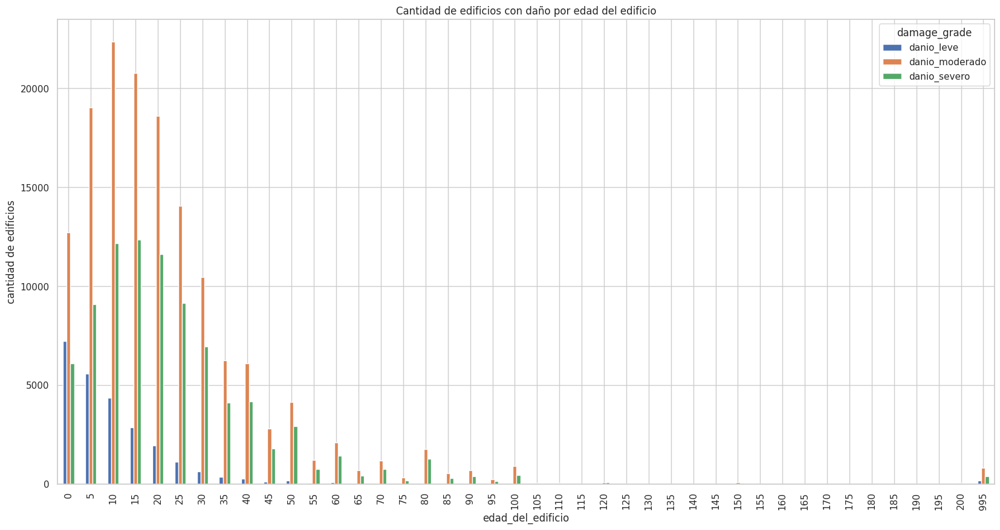

In [ ]:
tabla_cantidad_de_edificios_segun_danio[['danio_leve','danio_moderado','danio_severo']].plot(kind='bar',figsize=(20,10),title='Cantidad de edificios con daño por edad del edificio', ylabel='cantidad de edificios')

Daño severo

In [ ]:
cantidad_de_edificios_con_danio_severo =  tabla_cantidad_de_edificios_segun_danio[['danio_severo','total_de_edificios']]

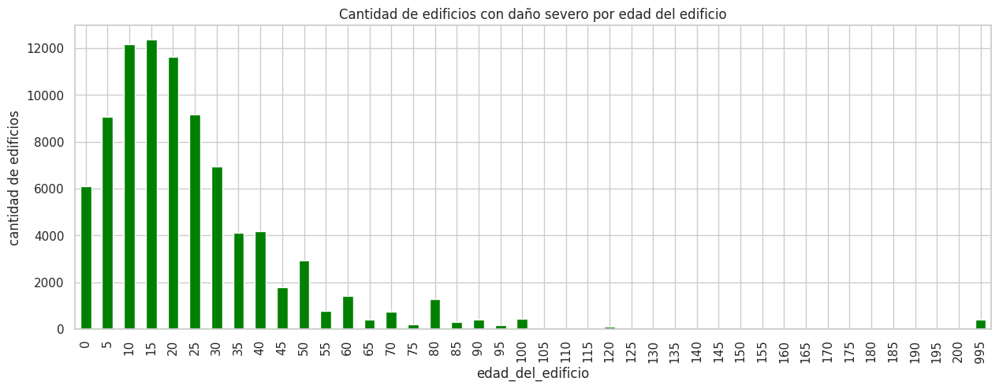

In [ ]:
cantidad_de_edificios_con_danio_severo['danio_severo'].plot(kind='bar',figsize=(15,5),title='Cantidad de edificios con daño severo por edad del edificio',color='green', ylabel='cantidad de edificios')

Daño moderado

In [ ]:
cantidad_de_edificios_con_danio_moderado =  tabla_cantidad_de_edificios_segun_danio[['danio_moderado','total_de_edificios']]

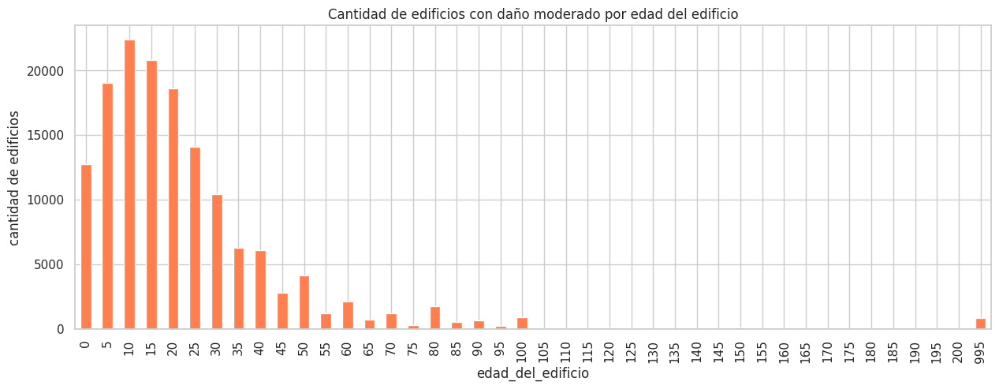

In [ ]:
cantidad_de_edificios_con_danio_moderado['danio_moderado'].plot(kind='bar',figsize=(15,5),title='Cantidad de edificios con daño moderado por edad del edificio',color='coral', ylabel='cantidad de edificios')

Daño leve

In [ ]:
cantidad_de_edificios_con_danio_leve =  tabla_cantidad_de_edificios_segun_danio[['danio_leve','total_de_edificios']]

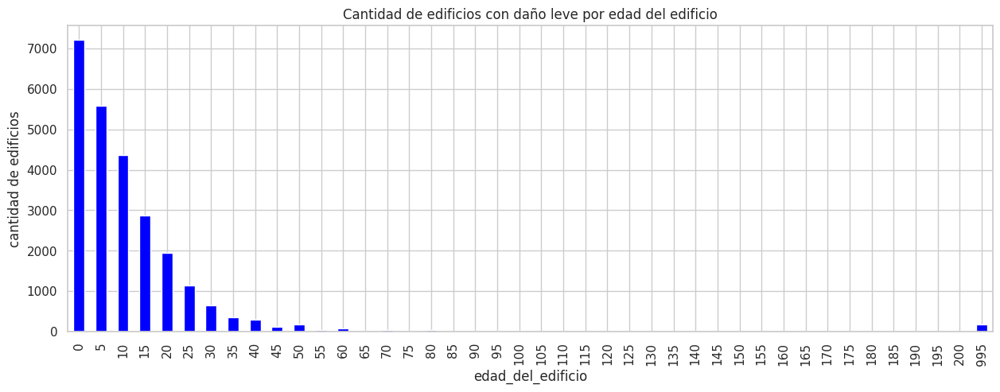

In [ ]:
cantidad_de_edificios_con_danio_leve['danio_leve'].plot(kind='bar',figsize=(15,5),title='Cantidad de edificios con daño leve por edad del edificio',color='blue', ylabel='cantidad de edificios')

Promedio daño severo

In [ ]:
promedio_edificios_con_danio_severo = ((cantidad_de_edificios_con_danio_severo['danio_severo']*100)/cantidad_de_edificios_con_danio_severo['total_de_edificios']).to_frame().rename(columns={0:'porcentaje_edificios_con_danio_severo'})

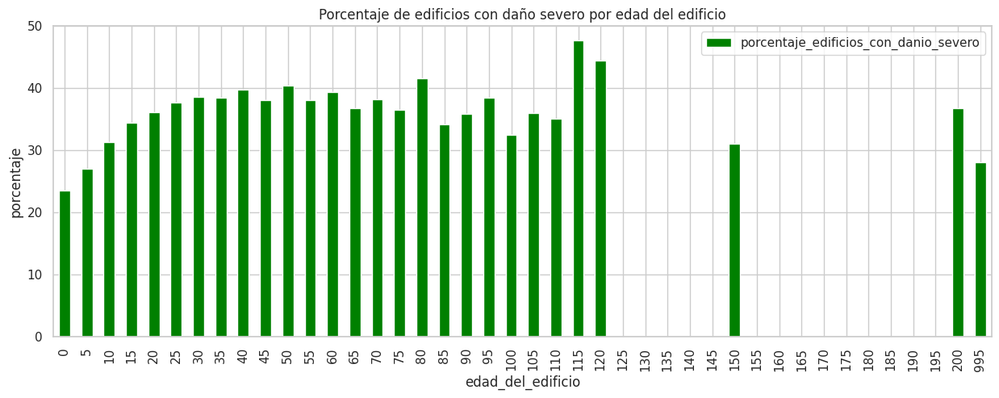

In [ ]:
promedio_edificios_con_danio_severo.plot(kind='bar',figsize=(15,5),title='Porcentaje de edificios con daño severo por edad del edificio',color='green', ylabel='porcentaje')

Promedio daño moderado

In [ ]:
promedio_edificios_con_danio_moderado = ((cantidad_de_edificios_con_danio_moderado['danio_moderado']*100)/cantidad_de_edificios_con_danio_moderado['total_de_edificios']).to_frame().rename(columns={0:'porcentaje_edificios_con_danio_moderado'})

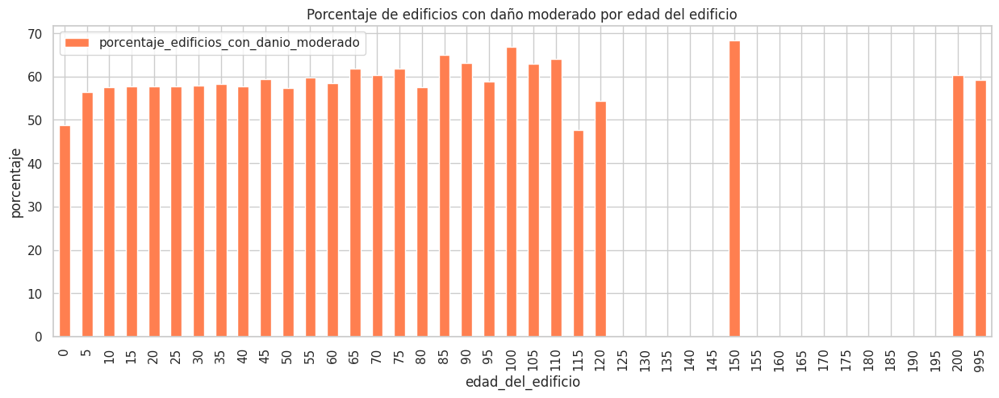

In [ ]:
promedio_edificios_con_danio_moderado.plot(kind='bar',figsize=(15,5),title='Porcentaje de edificios con daño moderado por edad del edificio',color='coral', ylabel='porcentaje')

Promedio daño leve

In [ ]:
promedio_edificios_con_danio_leve = ((cantidad_de_edificios_con_danio_leve['danio_leve']*100)/cantidad_de_edificios_con_danio_leve['total_de_edificios']).to_frame().rename(columns={0:'porcentaje_edificios_con_danio_leve'})

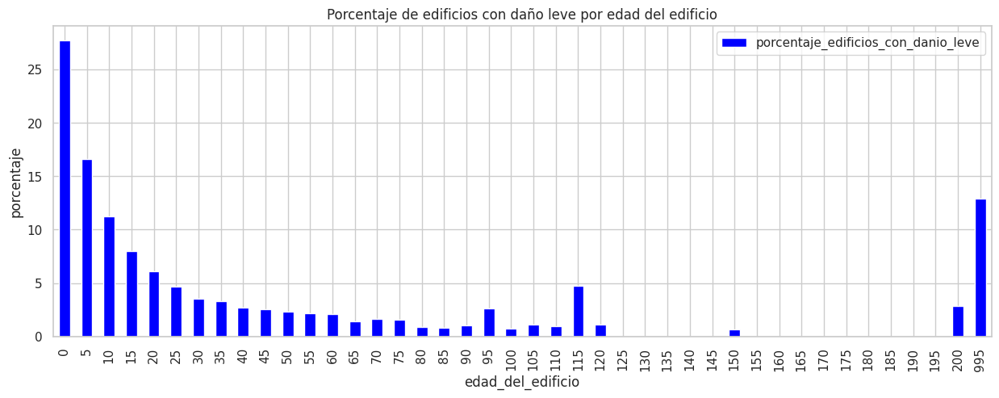

In [ ]:
promedio_edificios_con_danio_leve.plot(kind='bar',figsize=(15,5),title='Porcentaje de edificios con daño leve por edad del edificio',color='blue', ylabel='porcentaje')

In [ ]:
edificaciones_de_995_anios_segun_material_de_construccion = df_train_values.loc[df_train_values['age']==995,:].iloc[:,15:26].sum().to_frame()

In [ ]:
edificaciones_de_995_anios_segun_material_de_construccion

,0
has_superstructure_adobe_mud,194
has_superstructure_mud_mortar_stone,1037
has_superstructure_stone_flag,68
has_superstructure_cement_mortar_stone,22
has_superstructure_mud_mortar_brick,132
has_superstructure_cement_mortar_brick,81
has_superstructure_timber,481
has_superstructure_bamboo,144
has_superstructure_rc_non_engineered,45
has_superstructure_rc_engineered,20


In [ ]:
edificaciones_de_995_anios_segun_material_de_construccion.rename(index={'has_superstructure_adobe_mud':'adobe y barro', 'has_superstructure_mud_mortar_stone':'barro y piedra', 'has_superstructure_stone_flag':'piedra', 'has_superstructure_cement_mortar_stone':'cemento y piedra', 'has_superstructure_mud_mortar_brick':'barro y ladrillos', 'has_superstructure_cement_mortar_brick':'cemento y ladrillos', 'has_superstructure_timber':'timber', 'has_superstructure_bamboo':'bambu', 'has_superstructure_rc_non_engineered':'concreto no diseñado', 'has_superstructure_rc_engineered':'concreto diseñado', 'has_superstructure_other':'otro material'   }, inplace=True)

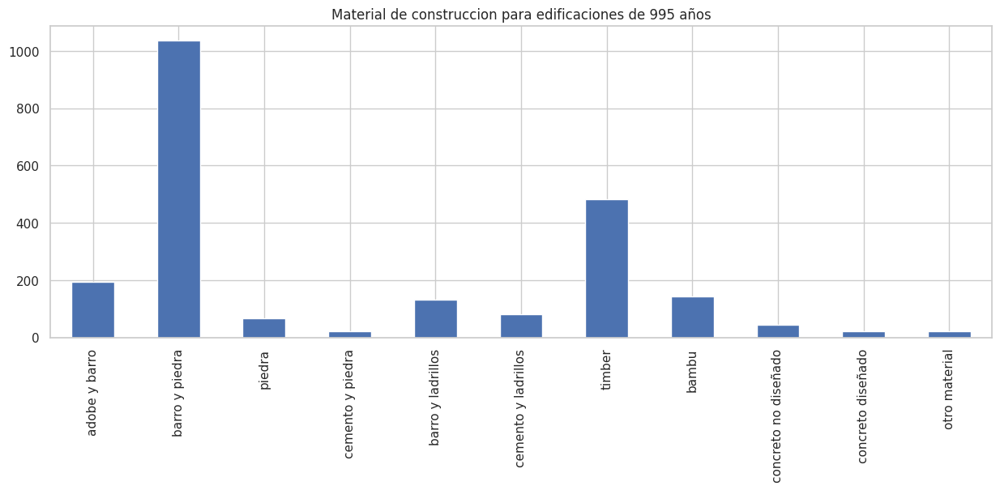

In [ ]:
edificaciones_de_995_anios_segun_material_de_construccion.plot(kind='bar',figsize=(15,5),title='Material de construccion para edificaciones de 995 años', ylabel='', legend=False )

In [ ]:
edificaciones_de_120_anios_segun_material_de_construccion = df_train_values.loc[df_train_values['age']==120,:].iloc[:,15:26].sum().to_frame()

In [ ]:
edificaciones_de_120_anios_segun_material_de_construccion.rename(index={'has_superstructure_adobe_mud':'adobe y barro', 'has_superstructure_mud_mortar_stone':'barro y piedra', 'has_superstructure_stone_flag':'piedra', 'has_superstructure_cement_mortar_stone':'cemento y piedra', 'has_superstructure_mud_mortar_brick':'barro y ladrillos', 'has_superstructure_cement_mortar_brick':'cemento y ladrillos', 'has_superstructure_timber':'timber', 'has_superstructure_bamboo':'bambu', 'has_superstructure_rc_non_engineered':'concreto no diseñado', 'has_superstructure_rc_engineered':'concreto diseñado', 'has_superstructure_other':'otro material'   }, inplace=True)

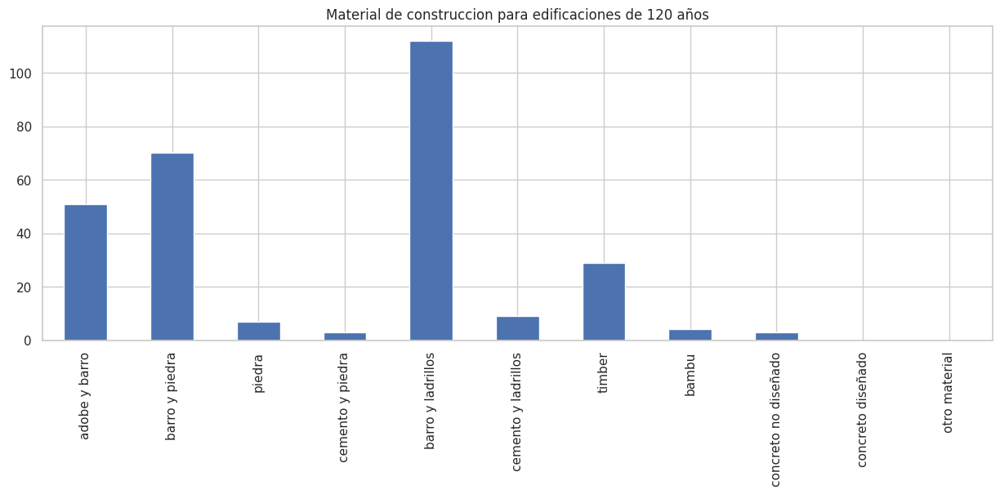

In [ ]:
edificaciones_de_120_anios_segun_material_de_construccion.plot(kind='bar',figsize=(15,5),title='Material de construccion para edificaciones de 120 años', ylabel='', legend=False )

In [ ]:
edificaciones_de_180_anios_segun_material_de_construccion = df_train_values.loc[df_train_values['age']==180,:].iloc[:,15:26].sum().to_frame()

In [ ]:
edificaciones_de_180_anios_segun_material_de_construccion.rename(index={'has_superstructure_adobe_mud':'adobe y barro', 'has_superstructure_mud_mortar_stone':'barro y piedra', 'has_superstructure_stone_flag':'piedra', 'has_superstructure_cement_mortar_stone':'cemento y piedra', 'has_superstructure_mud_mortar_brick':'barro y ladrillos', 'has_superstructure_cement_mortar_brick':'cemento y ladrillos', 'has_superstructure_timber':'timber', 'has_superstructure_bamboo':'bambu', 'has_superstructure_rc_non_engineered':'concreto no diseñado', 'has_superstructure_rc_engineered':'concreto diseñado', 'has_superstructure_other':'otro material'   }, inplace=True)

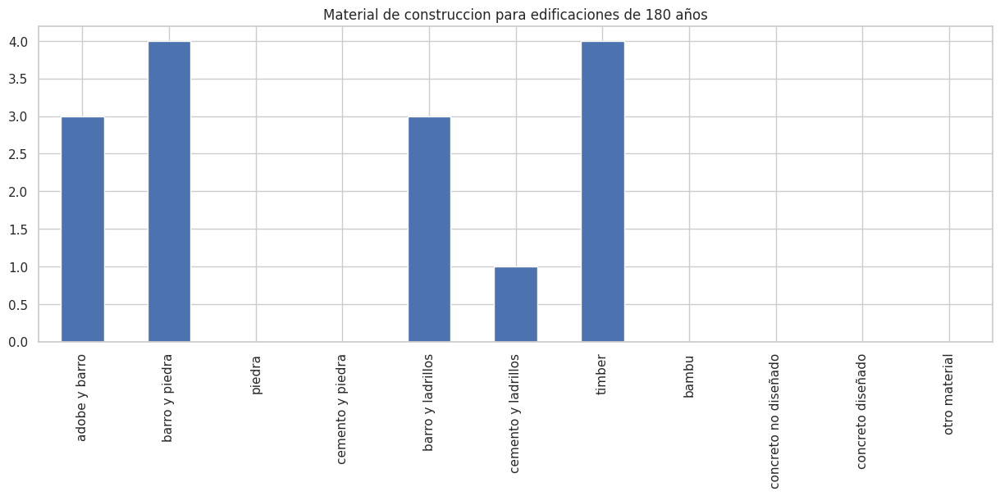

In [ ]:
edificaciones_de_180_anios_segun_material_de_construccion.plot(kind='bar',figsize=(15,5),title='Material de construccion para edificaciones de 180 años', ylabel='', legend=False )

# Daño de los edificios segun el material de costruccion utilizado

# Edificacion construida con adobe/barro 

In [ ]:
edificaciones_contruidas_con_barro = df_train_values.loc[df_train_values['has_superstructure_adobe_mud']==1,['building_id']]

In [ ]:
danios_edificios_construidos_con_barro = edificaciones_contruidas_con_barro.merge(df_train_labels, left_on='building_id', right_on='building_id', how='inner')['damage_grade'].to_frame().rename(columns={'damage_grade':'tipo_de_danio_edificios_de_barro'})

In [ ]:
danios_edificios_construidos_con_barro = danios_edificios_construidos_con_barro.value_counts().to_frame().rename(index={1:'danio_leve',2:'danio_moderado',3:'danio_severo'},columns={0:'cantidad_de_edificios'})

In [ ]:
danios_edificios_construidos_con_barro.head()

,cantidad_de_edificios
tipo_de_danio_edificios_de_barro,
danio_moderado,13902
danio_severo,8605
danio_leve,594


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c56a5610>],
      dtype=object)

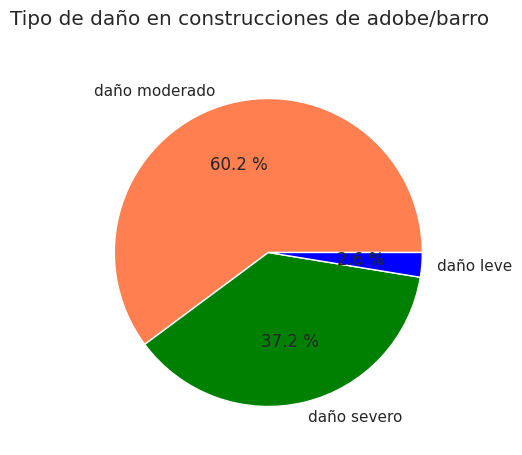

In [ ]:
danios_edificios_construidos_con_barro.plot(kind='pie', subplots=True,figsize=(15,5),title='Tipo de daño en construcciones de adobe/barro', labels=['daño moderado','daño severo', 'daño leve'], colors=['coral','green','blue'],  autopct='%0.1f %%', ylabel='', legend=False )

# Edificacion construida con barro/piedra

In [ ]:
edificaciones_contruidas_con_piedra_barro = df_train_values.loc[df_train_values['has_superstructure_mud_mortar_stone']==1,['building_id']]

In [ ]:
danios_edificios_construidos_con_piedra_barro = edificaciones_contruidas_con_piedra_barro.merge(df_train_labels, left_on='building_id', right_on='building_id', how='inner')['damage_grade'].to_frame().rename(columns={'damage_grade':'tipo_de_danio_edificios_de_piedra_y_barro'})

In [ ]:
danios_edificios_construidos_con_piedra_barro = danios_edificios_construidos_con_piedra_barro.value_counts().to_frame().rename(index={1:'danio_leve',2:'danio_moderado',3:'danio_severo'},columns={0:'cantidad_de_edificios'})

In [ ]:
danios_edificios_construidos_con_piedra_barro.head()

,cantidad_de_edificios
tipo_de_danio_edificios_de_piedra_y_barro,
danio_moderado,113947
danio_severo,75854
danio_leve,8760


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c5541610>],
      dtype=object)

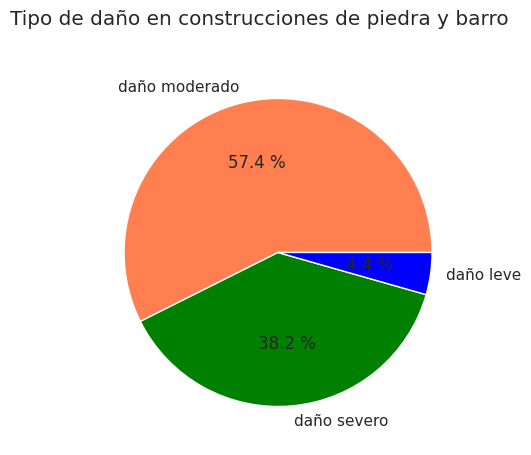

In [ ]:
danios_edificios_construidos_con_piedra_barro.plot(kind='pie', subplots=True,figsize=(15,5),title='Tipo de daño en construcciones de piedra y barro', labels=['daño moderado','daño severo', 'daño leve'], colors=['coral','green','blue'], autopct='%0.1f %%', ylabel='', legend=False )

# Edificacion construida con piedra

In [ ]:
edificaciones_contruidas_con_piedra = df_train_values.loc[df_train_values['has_superstructure_stone_flag']==1,['building_id']]

In [ ]:
danios_edificios_construidos_con_piedra = edificaciones_contruidas_con_piedra.merge(df_train_labels, left_on='building_id', right_on='building_id', how='inner')['damage_grade'].to_frame().rename(columns={'damage_grade':'tipo_de_danio_edificios_de_piedra'})

In [ ]:
danios_edificios_construidos_con_piedra = danios_edificios_construidos_con_piedra.value_counts().to_frame().rename(index={1:'danio_leve',2:'danio_moderado',3:'danio_severo'},columns={0:'cantidad_de_edificios'})

In [ ]:
danios_edificios_construidos_con_piedra.head()

,cantidad_de_edificios
tipo_de_danio_edificios_de_piedra,
danio_moderado,4534
danio_severo,4231
danio_leve,182


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c5528450>],
      dtype=object)

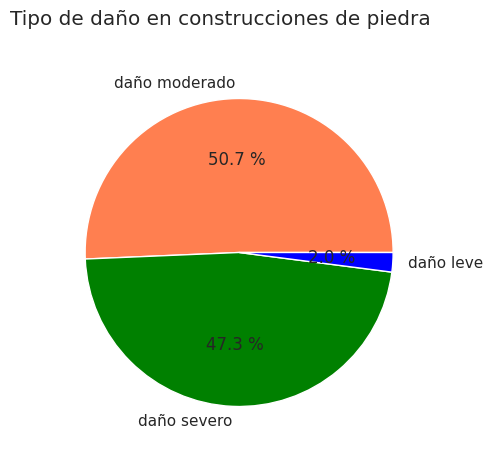

In [ ]:
danios_edificios_construidos_con_piedra.plot(kind='pie', subplots=True,figsize=(15,5),title='Tipo de daño en construcciones de piedra', labels=['daño moderado','daño severo', 'daño leve'], colors=['coral','green','blue'], autopct='%0.1f %%', ylabel='', legend=False )

# Edificacion construida con cemento/piedra

In [ ]:
edificaciones_contruidas_con_cemento_piedra = df_train_values.loc[df_train_values['has_superstructure_cement_mortar_stone']==1,['building_id']]

In [ ]:
danios_edificios_construidos_con_cemento_piedra = edificaciones_contruidas_con_cemento_piedra.merge(df_train_labels, left_on='building_id', right_on='building_id', how='inner')['damage_grade'].to_frame().rename(columns={'damage_grade':'tipo_de_danio_edificios_de_cemento_piedra'})

In [ ]:
danios_edificios_construidos_con_cemento_piedra = danios_edificios_construidos_con_cemento_piedra.value_counts().to_frame().rename(index={1:'danio_leve',2:'danio_moderado',3:'danio_severo'},columns={0:'cantidad_de_edificios'})

In [ ]:
danios_edificios_construidos_con_cemento_piedra.head()

,cantidad_de_edificios
tipo_de_danio_edificios_de_cemento_piedra,
danio_moderado,3248
danio_leve,829
danio_severo,675


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c547d3d0>],
      dtype=object)

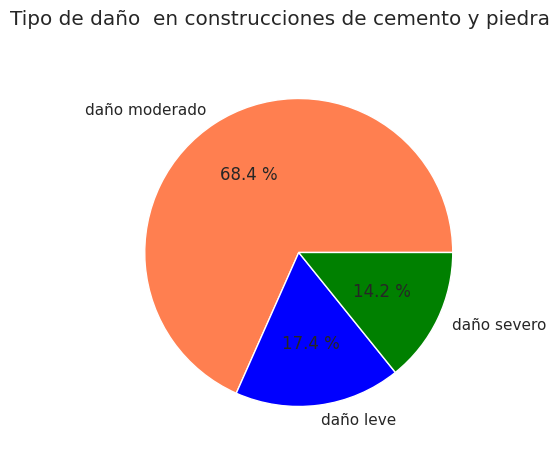

In [ ]:
danios_edificios_construidos_con_cemento_piedra.plot(kind='pie', subplots=True,figsize=(15,5),title='Tipo de daño  en construcciones de cemento y piedra', labels=['daño moderado','daño leve', 'daño severo'], colors=['coral','blue','green'], autopct='%0.1f %%', ylabel='', legend=False )

# Edificacion construida con barro y ladrillos

In [ ]:
edificaciones_contruidas_con_barro_ladrillos = df_train_values.loc[df_train_values['has_superstructure_mud_mortar_brick']==1,['building_id']]

In [ ]:
danios_edificios_construidos_con_barro_ladrillos = edificaciones_contruidas_con_barro_ladrillos.merge(df_train_labels, left_on='building_id', right_on='building_id', how='inner')['damage_grade'].to_frame().rename(columns={'damage_grade':'tipo_de_danio_edificios_de_barro_ladrillos'})

In [ ]:
danios_edificios_construidos_con_barro_ladrillos = danios_edificios_construidos_con_barro_ladrillos.value_counts().to_frame().rename(index={1:'danio_leve',2:'danio_moderado',3:'danio_severo'},columns={0:'cantidad_de_edificios'})

In [ ]:
danios_edificios_construidos_con_barro_ladrillos.head()

,cantidad_de_edificios
tipo_de_danio_edificios_de_barro_ladrillos,
danio_moderado,11698
danio_severo,5440
danio_leve,623


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c543da90>],
      dtype=object)

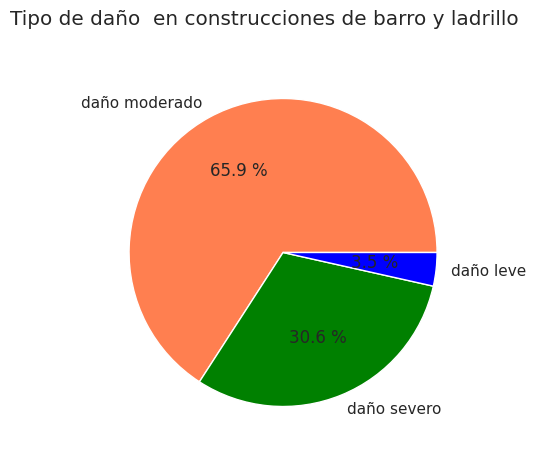

In [ ]:
danios_edificios_construidos_con_barro_ladrillos.plot(kind='pie', subplots=True,figsize=(15,5),title='Tipo de daño  en construcciones de barro y ladrillo', labels=['daño moderado','daño severo', 'daño leve'], colors=['coral','green','blue'], autopct='%0.1f %%', ylabel='', legend=False )

# Edificacion construida con cemento y ladrillos

In [ ]:
edificaciones_contruidas_con_cemento_ladrillos = df_train_values.loc[df_train_values['has_superstructure_cement_mortar_brick']==1,['building_id']]

In [ ]:
danios_edificios_construidos_con_cemento_ladrillos = edificaciones_contruidas_con_cemento_ladrillos.merge(df_train_labels, left_on='building_id', right_on='building_id', how='inner')['damage_grade'].to_frame().rename(columns={'damage_grade':'tipo_de_danio_edificios_de_cemento_ladrillos'})

In [ ]:
danios_edificios_construidos_con_cemento_ladrillos = danios_edificios_construidos_con_cemento_ladrillos.value_counts().to_frame().rename(index={1:'danio_leve',2:'danio_moderado',3:'danio_severo'},columns={0:'cantidad_de_edificios'})

In [ ]:
danios_edificios_construidos_con_cemento_ladrillos.head()

,cantidad_de_edificios
tipo_de_danio_edificios_de_cemento_ladrillos,
danio_moderado,11421
danio_leve,7105
danio_severo,1089


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c53bea50>],
      dtype=object)

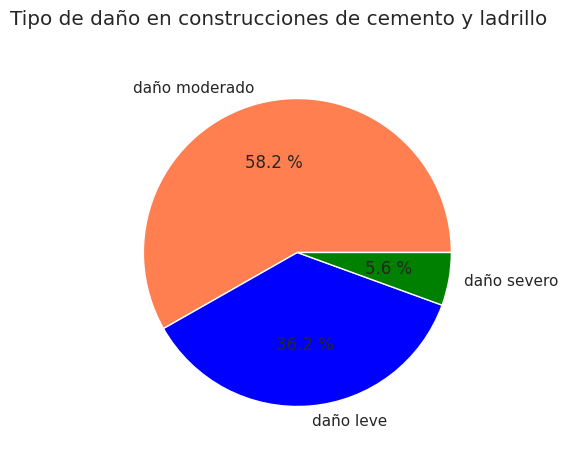

In [ ]:
danios_edificios_construidos_con_cemento_ladrillos.plot(kind='pie', subplots=True,figsize=(15,5),title='Tipo de daño en construcciones de cemento y ladrillo', labels=['daño moderado','daño leve', 'daño severo'], colors=['coral','blue','green'], autopct='%0.1f %%', ylabel='', legend=False )

# Edificacion construida con timber

In [ ]:
edificaciones_contruidas_con_timber = df_train_values.loc[df_train_values['has_superstructure_timber']==1,['building_id']]

In [ ]:
danios_edificios_construidos_con_timber = edificaciones_contruidas_con_timber.merge(df_train_labels, left_on='building_id', right_on='building_id', how='inner')['damage_grade'].to_frame().rename(columns={'damage_grade':'tipo_de_danio_edificios_de_timber'})

In [ ]:
danios_edificios_construidos_con_timber = danios_edificios_construidos_con_timber.value_counts().to_frame().rename(index={1:'danio_leve',2:'danio_moderado',3:'danio_severo'},columns={0:'cantidad_de_edificios'})

In [ ]:
danios_edificios_construidos_con_timber.head()

,cantidad_de_edificios
tipo_de_danio_edificios_de_timber,
danio_moderado,40187
danio_severo,18621
danio_leve,7642


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c539d3d0>],
      dtype=object)

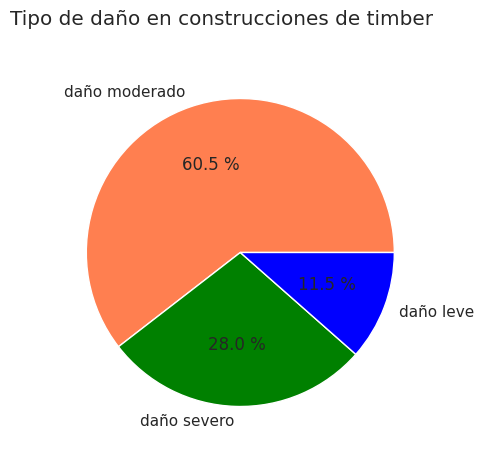

In [ ]:
danios_edificios_construidos_con_timber.plot(kind='pie', subplots=True,figsize=(15,5),title='Tipo de daño en construcciones de timber', labels=['daño moderado','daño severo', 'daño leve'], colors=['coral','green','blue'], autopct='%0.1f %%', ylabel='', legend=False )

# Edificacion construida con bambu

In [ ]:
edificaciones_contruidas_con_bambu = df_train_values.loc[df_train_values['has_superstructure_bamboo']==1,['building_id']]

In [ ]:
danios_edificios_construidos_con_bambu = edificaciones_contruidas_con_bambu.merge(df_train_labels, left_on='building_id', right_on='building_id', how='inner')['damage_grade'].to_frame().rename(columns={'damage_grade':'tipo_de_danio_edificios_de_bambu'})

In [ ]:
danios_edificios_construidos_con_bambu = danios_edificios_construidos_con_bambu.value_counts().to_frame().rename(index={1:'danio_leve',2:'danio_moderado',3:'danio_severo'},columns={0:'cantidad_de_edificios'})

In [ ]:
danios_edificios_construidos_con_bambu.head()

,cantidad_de_edificios
tipo_de_danio_edificios_de_bambu,
danio_moderado,14001
danio_severo,5314
danio_leve,2839


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c53720d0>],
      dtype=object)

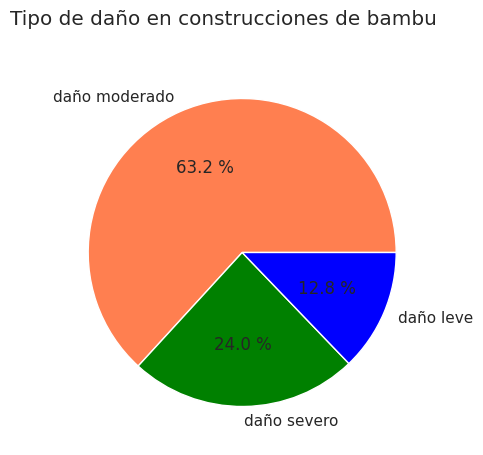

In [ ]:
danios_edificios_construidos_con_bambu.plot(kind='pie', subplots=True,figsize=(15,5),title='Tipo de daño en construcciones de bambu', labels=['daño moderado','daño severo', 'daño leve'], colors=['coral','green','blue'], autopct='%0.1f %%', ylabel='', legend=False )

# Edificacion construida con concreto reforzado no diseñado

In [ ]:
edificaciones_contruidas_con_concreto_no_diseniado = df_train_values.loc[df_train_values['has_superstructure_rc_non_engineered']==1,['building_id']]

In [ ]:
danios_edificios_construidos_con_concreto_no_diseniado = edificaciones_contruidas_con_concreto_no_diseniado.merge(df_train_labels, left_on='building_id', right_on='building_id', how='inner')['damage_grade'].to_frame().rename(columns={'damage_grade':'tipo_de_danio_edificios_de_concreto_reforzado_no_diseniado'})

In [ ]:
danios_edificios_construidos_con_concreto_no_diseniado = danios_edificios_construidos_con_concreto_no_diseniado.value_counts().to_frame().rename(index={1:'danio_leve',2:'danio_moderado',3:'danio_severo'},columns={0:'cantidad_de_edificios'})

In [ ]:
danios_edificios_construidos_con_concreto_no_diseniado.head()

,cantidad_de_edificios
tipo_de_danio_edificios_de_concreto_reforzado_no_diseniado,
danio_moderado,5832
danio_leve,3857
danio_severo,1410


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c5a87750>],
      dtype=object)

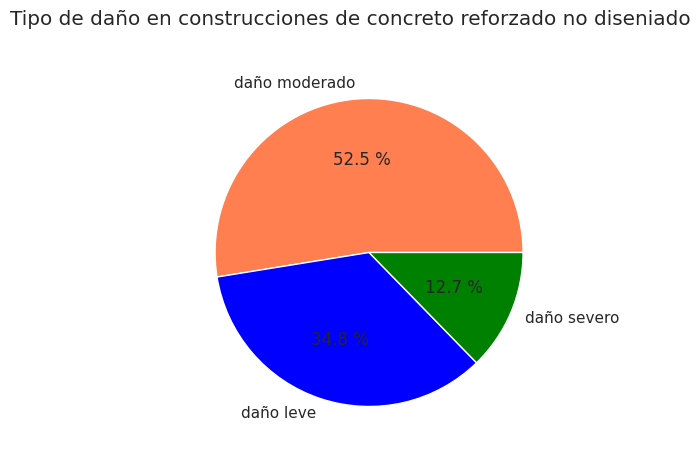

In [ ]:
danios_edificios_construidos_con_concreto_no_diseniado.plot(kind='pie', subplots=True,figsize=(15,5),title='Tipo de daño en construcciones de concreto reforzado no diseniado', labels=['daño moderado','daño leve', 'daño severo'], colors=['coral','blue','green'], autopct='%0.1f %%', ylabel='', legend=False )

# Edificacion construida con concreto reforzado diseñado

In [ ]:
edificaciones_contruidas_con_concreto_diseniado = df_train_values.loc[df_train_values['has_superstructure_rc_engineered']==1,['building_id']]

In [ ]:
danios_edificios_construidos_con_concreto_diseniado = edificaciones_contruidas_con_concreto_diseniado.merge(df_train_labels, left_on='building_id', right_on='building_id', how='inner')['damage_grade'].to_frame().rename(columns={'damage_grade':'tipo_de_danio_edificios_de_concreto_reforzado_diseniado'})

In [ ]:
danios_edificios_construidos_con_concreto_diseniado = danios_edificios_construidos_con_concreto_diseniado.value_counts().to_frame().rename(index={1:'danio_leve',2:'danio_moderado',3:'danio_severo'},columns={0:'cantidad_de_edificios'})

In [ ]:
danios_edificios_construidos_con_concreto_diseniado.head()

,cantidad_de_edificios
tipo_de_danio_edificios_de_concreto_reforzado_diseniado,
danio_leve,2656
danio_moderado,1402
danio_severo,75


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c580e850>],
      dtype=object)

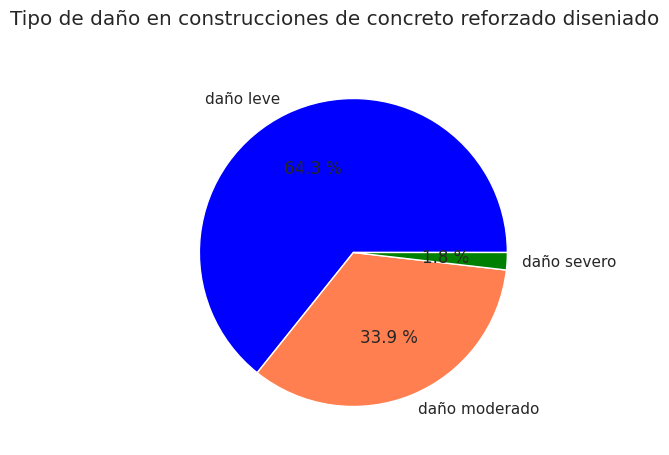

In [ ]:
danios_edificios_construidos_con_concreto_diseniado.plot(kind='pie', subplots=True,figsize=(15,5),title='Tipo de daño en construcciones de concreto reforzado diseniado', labels=['daño leve','daño moderado', 'daño severo'], colors=['blue','coral','green'], autopct='%0.1f %%', ylabel='', legend=False )

# Edificacion construida con otro material


In [ ]:
edificaciones_contruidas_con_otro_material = df_train_values.loc[df_train_values['has_superstructure_other']==1,['building_id']]

In [ ]:
danios_edificios_construidos_con_otro_material = edificaciones_contruidas_con_otro_material.merge(df_train_labels, left_on='building_id', right_on='building_id', how='inner')['damage_grade'].to_frame().rename(columns={'damage_grade':'tipo_de_danio_edificios_de_otro_material'})

In [ ]:
danios_edificios_construidos_con_otro_material = danios_edificios_construidos_con_otro_material.value_counts().to_frame().rename(index={1:'danio_leve',2:'danio_moderado',3:'danio_severo'},columns={0:'cantidad_de_edificios'})

In [ ]:
danios_edificios_construidos_con_otro_material.head()

,cantidad_de_edificios
tipo_de_danio_edificios_de_otro_material,
danio_moderado,2248
danio_severo,1001
danio_leve,656


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c58fbdd0>],
      dtype=object)

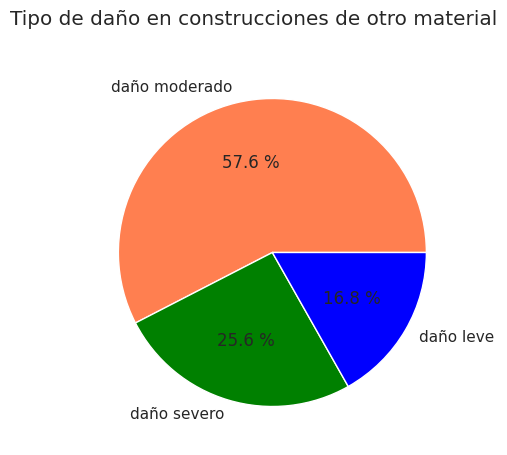

In [ ]:
danios_edificios_construidos_con_otro_material.plot(kind='pie', subplots=True,figsize=(15,5),title='Tipo de daño en construcciones de otro material', labels=['daño moderado','daño severo', 'daño leve'], colors=['coral','green','blue'], autopct='%0.1f %%', ylabel='', legend=False )

# Edificaciones con usos secundarios

In [ ]:
danio_segun_si_tiene_o_no_uso_secundario = df_train_values.loc[:,['building_id','has_secondary_use']].merge(df_train_labels, left_on='building_id', right_on='building_id', how='inner')[['has_secondary_use','damage_grade']].rename(columns={'damage_grade':'tipo_de_danio'})

In [ ]:
danio_segun_si_tiene_o_no_uso_secundario.head()

,has_secondary_use,tipo_de_danio
0,0,3
1,0,2
2,0,3
3,0,2
4,0,3


In [ ]:
tiene_uso_secundario = danio_segun_si_tiene_o_no_uso_secundario.loc[danio_segun_si_tiene_o_no_uso_secundario['has_secondary_use']==1,'tipo_de_danio'].value_counts().to_frame()

In [ ]:
tiene_uso_secundario.rename(index={1:'danio_leve',2:'danio_moderado',3:'danio_severo'},inplace=True)

In [ ]:
tiene_uso_secundario.head()

,tipo_de_danio
danio_moderado,17715
danio_severo,7193
danio_leve,4248


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c6368090>],
      dtype=object)

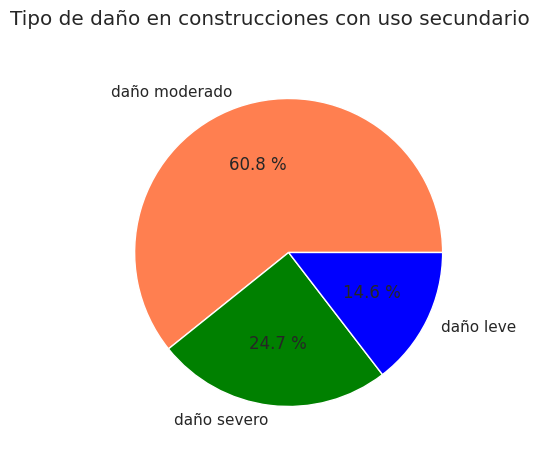

In [ ]:
tiene_uso_secundario.plot(kind='pie', subplots=True,figsize=(15,5),title='Tipo de daño en construcciones con uso secundario', labels=['daño moderado','daño severo', 'daño leve'], colors=['coral','green','blue'], autopct='%0.1f %%', ylabel='', legend=False )

In [ ]:
no_tiene_uso_secundario = danio_segun_si_tiene_o_no_uso_secundario.loc[danio_segun_si_tiene_o_no_uso_secundario['has_secondary_use']==0,'tipo_de_danio'].value_counts().to_frame()

In [ ]:
no_tiene_uso_secundario.rename(index={1:'danio_leve',2:'danio_moderado',3:'danio_severo'},inplace=True)

In [ ]:
no_tiene_uso_secundario.head()

,tipo_de_danio
danio_moderado,130544
danio_severo,80025
danio_leve,20876


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c51f1110>],
      dtype=object)

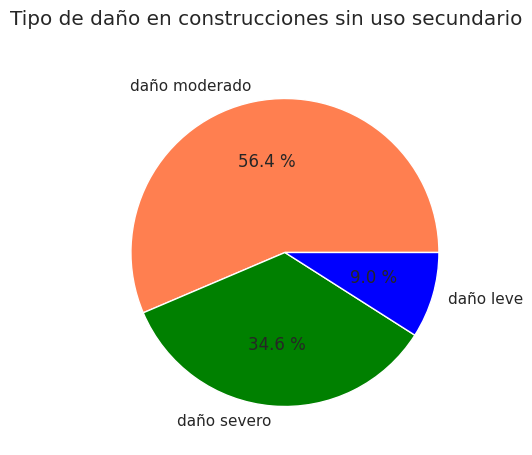

In [ ]:
no_tiene_uso_secundario.plot(kind='pie', subplots=True,figsize=(15,5),title='Tipo de daño en construcciones sin uso secundario', labels=['daño moderado','daño severo', 'daño leve'], colors=['coral','green','blue'], autopct='%0.1f %%', ylabel='', legend=False )

In [ ]:
edificaciones_con_uso_secundario_segun_material_de_construccion = df_train_values.loc[df_train_values['has_secondary_use']==1,:].iloc[:,15:26].sum().to_frame()

In [ ]:
edificaciones_con_uso_secundario_segun_material_de_construccion.rename(index={'has_superstructure_adobe_mud':'adobe y barro', 'has_superstructure_mud_mortar_stone':'barro y piedra', 'has_superstructure_stone_flag':'piedra', 'has_superstructure_cement_mortar_stone':'cemento y piedra', 'has_superstructure_mud_mortar_brick':'barro y ladrillos', 'has_superstructure_cement_mortar_brick':'cemento y ladrillos', 'has_superstructure_timber':'timber', 'has_superstructure_bamboo':'bambu', 'has_superstructure_rc_non_engineered':'concreto no diseñado', 'has_superstructure_rc_engineered':'concreto diseñado', 'has_superstructure_other':'otro material'  }, inplace=True)

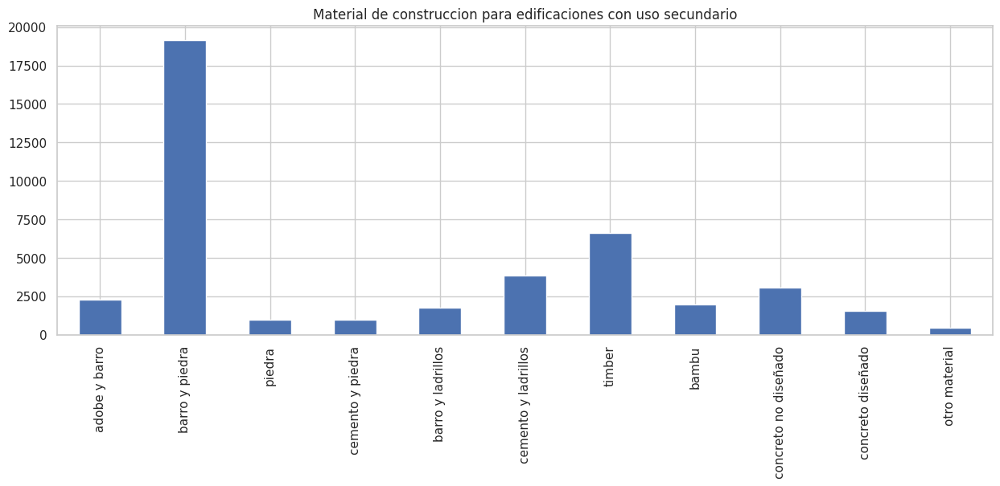

In [ ]:
edificaciones_con_uso_secundario_segun_material_de_construccion.plot(kind='bar',figsize=(15,5),title='Material de construccion para edificaciones con uso secundario', ylabel='', legend=False )

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c50dc510>],
      dtype=object)

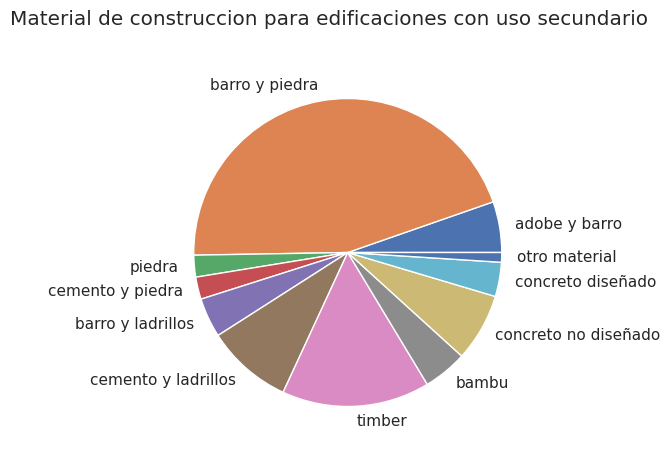

In [ ]:
edificaciones_con_uso_secundario_segun_material_de_construccion.plot(kind='pie', subplots=True,figsize=(15,5),title='Material de construccion para edificaciones con uso secundario', ylabel='', legend=False )

In [ ]:
edificaciones_sin_uso_secundario_segun_material_de_construccion = df_train_values.loc[df_train_values['has_secondary_use']==0,:].iloc[:,15:26].sum().to_frame()

In [ ]:
edificaciones_sin_uso_secundario_segun_material_de_construccion.rename(index={'has_superstructure_adobe_mud':'adobe y barro', 'has_superstructure_mud_mortar_stone':'barro y piedra', 'has_superstructure_stone_flag':'piedra', 'has_superstructure_cement_mortar_stone':'cemento y piedra', 'has_superstructure_mud_mortar_brick':'barro y ladrillos', 'has_superstructure_cement_mortar_brick':'cemento y ladrillos', 'has_superstructure_timber':'timber', 'has_superstructure_bamboo':'bambu', 'has_superstructure_rc_non_engineered':'concreto no diseñado', 'has_superstructure_rc_engineered':'concreto diseñado', 'has_superstructure_other':'otro material'   }, inplace=True)

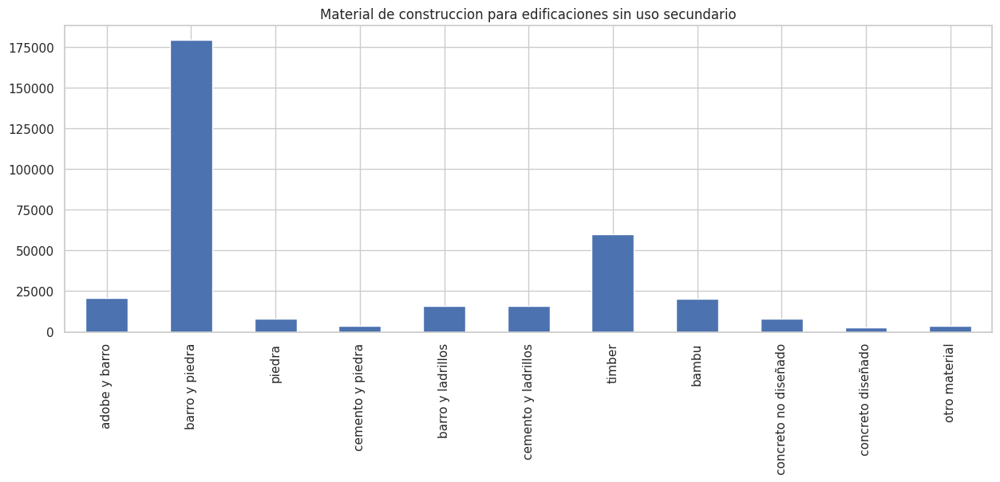

In [ ]:
edificaciones_sin_uso_secundario_segun_material_de_construccion.plot(kind='bar',figsize=(15,5),title='Material de construccion para edificaciones sin uso secundario', ylabel='', legend=False )

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c4fe64d0>],
      dtype=object)

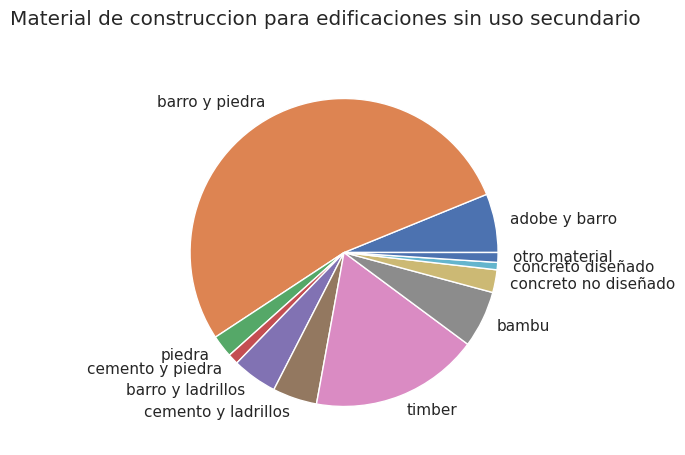

In [ ]:
edificaciones_sin_uso_secundario_segun_material_de_construccion.plot(kind='pie', subplots=True,figsize=(15,5),title='Material de construccion para edificaciones sin uso secundario', ylabel='', legend=False )

# Condicion de la superficie

In [ ]:
condicion_superficie = df_train_values.loc[:,['building_id','land_surface_condition']]

In [ ]:
condicion_superficie.head()

,building_id,land_surface_condition
0,802906,t
1,28830,o
2,94947,t
3,590882,t
4,201944,t


In [ ]:
danios_condicion_superficie = condicion_superficie.merge(df_train_labels, left_on='building_id', right_on='building_id',how='inner')[['land_surface_condition','damage_grade']]

In [ ]:
danios_condicion_superficie.head()

,land_surface_condition,damage_grade
0,t,3
1,o,2
2,t,3
3,t,2
4,t,3


In [ ]:
superficie_tipo_o = danios_condicion_superficie.loc[danios_condicion_superficie['land_surface_condition']=='o',:]['damage_grade'].value_counts().to_frame()

In [ ]:
superficie_tipo_o.rename(index={1:'danio_leve',2:'danio_moderado',3:'danio_severo'},inplace=True)

In [ ]:
superficie_tipo_o.head()

,damage_grade
danio_moderado,4708
danio_severo,3006
danio_leve,602


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c4f67cd0>],
      dtype=object)

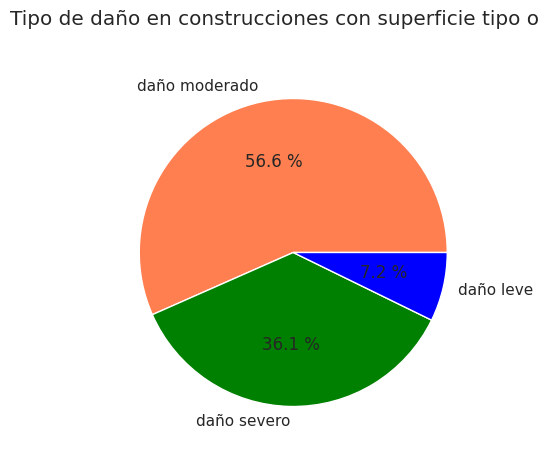

In [ ]:
superficie_tipo_o.plot(kind='pie', subplots=True,figsize=(15,5),title='Tipo de daño en construcciones con superficie tipo o', labels=['daño moderado','daño severo', 'daño leve'], colors=['coral','green','blue'], autopct='%0.1f %%', ylabel='', legend=False )

In [ ]:
superficie_tipo_t = danios_condicion_superficie.loc[danios_condicion_superficie['land_surface_condition']=='t',:]['damage_grade'].value_counts().to_frame()

In [ ]:
superficie_tipo_t.rename(index={1:'danio_leve',2:'danio_moderado',3:'danio_severo'},inplace=True)

In [ ]:
superficie_tipo_t.head()

,damage_grade
danio_moderado,122067
danio_severo,72724
danio_leve,21966


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c4838750>],
      dtype=object)

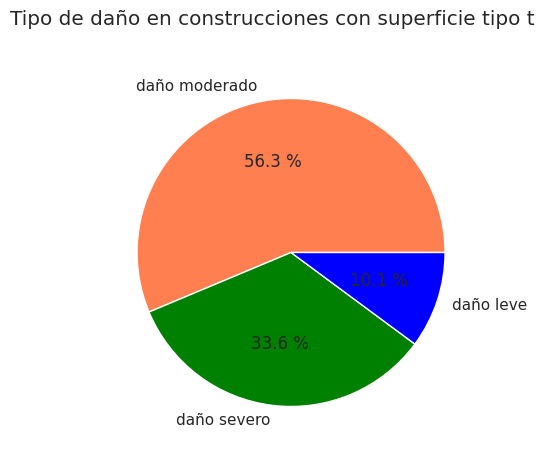

In [ ]:
superficie_tipo_t.plot(kind='pie', subplots=True,figsize=(15,5),title='Tipo de daño en construcciones con superficie tipo t', labels=['daño moderado','daño severo', 'daño leve'], colors=['coral','green','blue'], autopct='%0.1f %%', ylabel='', legend=False )

In [ ]:
superficie_tipo_n = danios_condicion_superficie.loc[danios_condicion_superficie['land_surface_condition']=='n',:]['damage_grade'].value_counts().to_frame()

In [ ]:
superficie_tipo_n.rename(index={1:'danio_leve',2:'danio_moderado',3:'danio_severo'},inplace=True)

In [ ]:
superficie_tipo_n.head()

,damage_grade
danio_moderado,21484
danio_severo,11488
danio_leve,2556


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fb8c4793350>],
      dtype=object)

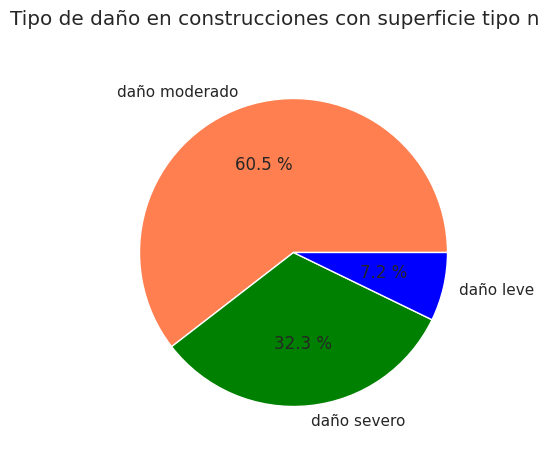

In [ ]:
superficie_tipo_n.plot(kind='pie', subplots=True,figsize=(15,5),title='Tipo de daño en construcciones con superficie tipo n', labels=['daño moderado','daño severo', 'daño leve'], colors=['coral','green','blue'], autopct='%0.1f %%', ylabel='', legend=False )

# Tipo de cimientos usado

In [ ]:
cimientos_usados = df_train_values.loc[:,['building_id','foundation_type']]

In [ ]:
cimientos_usados.head()

,building_id,foundation_type
0,802906,r
1,28830,r
2,94947,r
3,590882,r
4,201944,r


In [ ]:
danios_segun_cimientos = cimientos_usados.merge(df_train_labels, right_on='building_id', left_on='building_id', how='inner')[['foundation_type','damage_grade']]

In [ ]:
danios_segun_cimientos.head()

,foundation_type,damage_grade
0,r,3
1,r,2
2,r,3
3,r,2
4,r,3


In [ ]:
danios_segun_cimientos['total_edificaciones_con_cimientos'] = danios_segun_cimientos.groupby('foundation_type').transform('count')

In [ ]:
danios_segun_cimientos.head()

,foundation_type,damage_grade,total_edificaciones_con_cimientos
0,r,3,219196
1,r,2,219196
2,r,3,219196
3,r,2,219196
4,r,3,219196


In [ ]:
danio_severo_cimientos = danios_segun_cimientos.loc[danios_segun_cimientos['damage_grade']==1,['foundation_type','total_edificaciones_con_cimientos']]

In [ ]:
danio_severo_cimientos.head()

,foundation_type,total_edificaciones_con_cimientos
7,w,15118
9,i,10579
36,r,219196
45,i,10579
49,u,14260


In [ ]:
danio_severo_cimientos = danio_severo_cimientos.value_counts().to_frame().rename(columns={'foundation_type':'tipo_cimiento',0:'cantidad_de_edificaciones'}).rename(index={'r':'tipo r','i':'tipo i','w':'tipo w','u':'tipo u','h':'tipo h'}).reset_index().set_index('foundation_type')

In [ ]:
danio_severo_cimientos.head()

,total_edificaciones_con_cimientos,cantidad_de_edificaciones
foundation_type,,
tipo r,219196,10720
tipo i,10579,6004
tipo w,15118,4353
tipo u,14260,3689
tipo h,1448,358


In [ ]:
promedio_danio_severo = ((danio_severo_cimientos['cantidad_de_edificaciones']*100)/danio_severo_cimientos['total_edificaciones_con_cimientos']).to_frame()

In [ ]:
promedio_danio_severo

,0
foundation_type,
tipo r,4.89
tipo i,56.75
tipo w,28.79
tipo u,25.87
tipo h,24.72


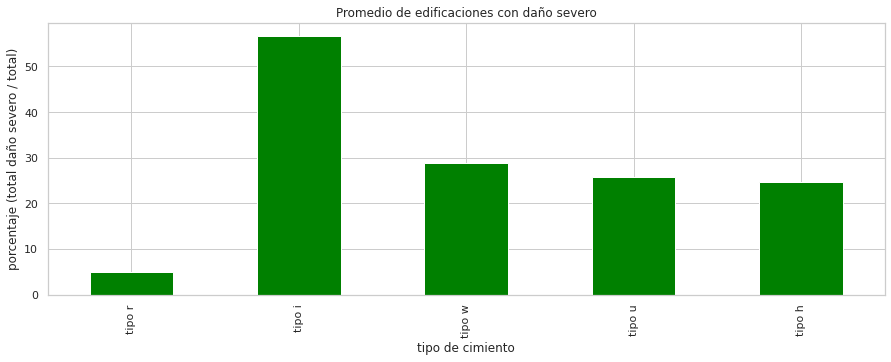

In [ ]:
promedio_danio_severo.plot(kind='bar',figsize=(15,5),title='Promedio de edificaciones con daño severo', color= 'green',ylabel='porcentaje (total daño severo / total)', xlabel='tipo de cimiento', legend=False )

In [ ]:
danio_moderado_cimientos = danios_segun_cimientos.loc[danios_segun_cimientos['damage_grade']==2,['foundation_type','total_edificaciones_con_cimientos']]

In [ ]:
danio_moderado_cimientos.head()

,foundation_type,total_edificaciones_con_cimientos
1,r,219196
3,r,219196
5,r,219196
8,r,219196
11,u,14260


In [ ]:
danio_moderado_cimientos = danio_moderado_cimientos.value_counts().to_frame().rename(columns={'foundation_type':'tipo_cimiento',0:'cantidad_de_edificaciones'}).rename(index={'r':'tipo r','i':'tipo i','w':'tipo w','u':'tipo u','h':'tipo h'}).reset_index().set_index('foundation_type')

In [ ]:
danio_moderado_cimientos.head()

,total_edificaciones_con_cimientos,cantidad_de_edificaciones
foundation_type,,
tipo r,219196,125515
tipo w,15118,9270
tipo u,14260,8541
tipo i,10579,4354
tipo h,1448,579


In [ ]:
promedio_danio_moderado = ((danio_moderado_cimientos['cantidad_de_edificaciones']*100)/danio_moderado_cimientos['total_edificaciones_con_cimientos']).to_frame()

In [ ]:
promedio_danio_moderado

,0
foundation_type,
tipo r,57.26
tipo w,61.32
tipo u,59.89
tipo i,41.16
tipo h,39.99


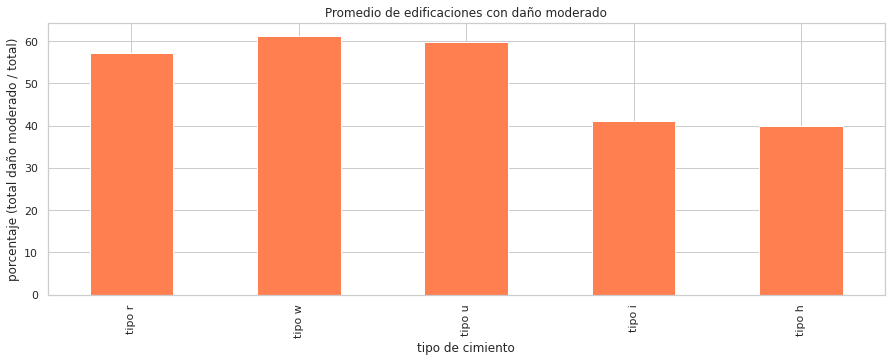

In [ ]:
promedio_danio_moderado.plot(kind='bar',figsize=(15,5),title='Promedio de edificaciones con daño moderado',color = 'coral',ylabel='porcentaje (total daño moderado / total)', xlabel='tipo de cimiento', legend=False )

In [ ]:
danio_leve_cimientos = danios_segun_cimientos.loc[danios_segun_cimientos['damage_grade']==3,['foundation_type','total_edificaciones_con_cimientos']]

In [ ]:
danio_leve_cimientos.head()

,foundation_type,total_edificaciones_con_cimientos
0,r,219196
2,r,219196
4,r,219196
6,r,219196
10,r,219196


In [ ]:
danio_leve_cimientos = danio_leve_cimientos.value_counts().to_frame().rename(columns={'foundation_type':'tipo_cimiento',0:'cantidad_de_edificaciones'}).rename(index={'r':'tipo r','i':'tipo i','w':'tipo w','u':'tipo u','h':'tipo h'}).reset_index().set_index('foundation_type')

In [ ]:
danio_leve_cimientos.head()

,total_edificaciones_con_cimientos,cantidad_de_edificaciones
foundation_type,,
tipo r,219196,82961
tipo u,14260,2030
tipo w,15118,1495
tipo h,1448,511
tipo i,10579,221


In [ ]:
promedio_danio_leve = ((danio_leve_cimientos['cantidad_de_edificaciones']*100)/danio_leve_cimientos['total_edificaciones_con_cimientos']).to_frame()

In [ ]:
promedio_danio_leve

,0
foundation_type,
tipo r,37.85
tipo u,14.24
tipo w,9.89
tipo h,35.29
tipo i,2.09


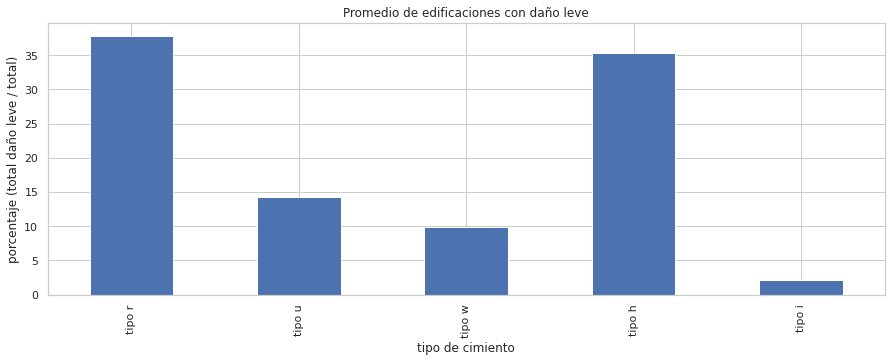

In [ ]:
promedio_danio_leve.plot(kind='bar',figsize=(15,5),title='Promedio de edificaciones con daño leve',ylabel='porcentaje (total daño leve / total)', xlabel='tipo de cimiento', legend=False )

# Formato de construccion antisismico

In [ ]:
formato_de_construccion = df_train_values.loc[:,['building_id','plan_configuration']]

In [ ]:
danio_segun_formato_de_construccion = formato_de_construccion.merge(df_train_labels, right_on='building_id', left_on='building_id',how='inner')[['plan_configuration','damage_grade']]

In [ ]:
danio_segun_formato_de_construccion.head()

,plan_configuration,damage_grade
0,d,3
1,d,2
2,d,3
3,d,2
4,d,3


In [ ]:
danio_segun_formato_de_construccion['total_edificaciones_con_formato'] = danio_segun_formato_de_construccion.groupby('plan_configuration').transform('count')

In [ ]:
danio_segun_formato_de_construccion.head()

,plan_configuration,damage_grade,total_edificaciones_con_formato
0,d,3,250072
1,d,2,250072
2,d,3,250072
3,d,2,250072
4,d,3,250072


In [ ]:
danio_severo_formato = danio_segun_formato_de_construccion.loc[danio_segun_formato_de_construccion['damage_grade']==1,['plan_configuration','total_edificaciones_con_formato']]

In [ ]:
danio_severo_formato.head()

,plan_configuration,total_edificaciones_con_formato
7,u,3649
9,d,250072
36,d,250072
45,d,250072
49,d,250072


In [ ]:
danio_severo_formato = danio_severo_formato.value_counts().to_frame().rename(columns={'plan_configuration':'tipo_formato',0:'cantidad_de_edificaciones'}).rename(index={'a':'tipo a','c':'tipo c','d':'tipo d','f':'tipo f','m':'tipo m','n':'tipo n','o':'tipo o','q':'tipo q','s':'tipo s','u':'tipo u'}).reset_index().set_index('plan_configuration')

In [ ]:
danio_severo_formato.head()

,total_edificaciones_con_formato,cantidad_de_edificaciones
plan_configuration,,
tipo d,250072,23310
tipo q,5692,781
tipo u,3649,774
tipo c,325,86
tipo a,252,66


In [ ]:
promedio_danio_severo_formato = ((danio_severo_formato['cantidad_de_edificaciones']*100)/danio_severo_formato['total_edificaciones_con_formato']).to_frame()

In [ ]:
promedio_danio_severo_formato

,0
plan_configuration,
tipo d,9.32
tipo q,13.72
tipo u,21.21
tipo c,26.46
tipo a,26.19
tipo s,15.32
tipo o,25.16
tipo m,17.39
tipo n,15.79


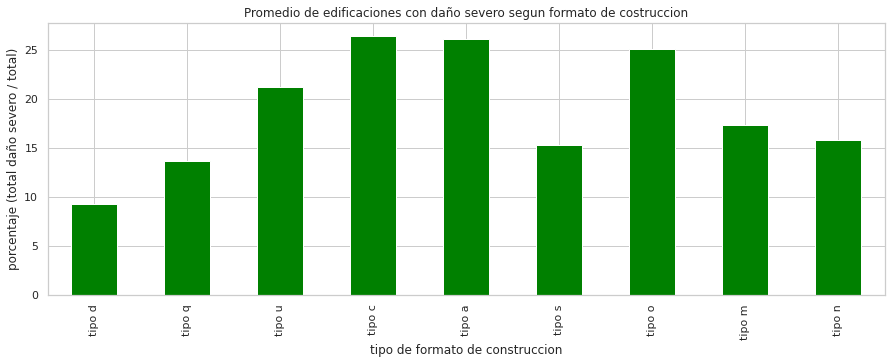

In [ ]:
promedio_danio_severo_formato.plot(kind='bar',figsize=(15,5),title='Promedio de edificaciones con daño severo segun formato de costruccion',ylabel='porcentaje (total daño severo / total)', color='green',xlabel='tipo de formato de construccion', legend=False )

In [ ]:
danio_moderado_formato = danio_segun_formato_de_construccion.loc[danio_segun_formato_de_construccion['damage_grade']==2,['plan_configuration','total_edificaciones_con_formato']]

In [ ]:
danio_moderado_formato.head()

,plan_configuration,total_edificaciones_con_formato
1,d,250072
3,d,250072
5,d,250072
8,d,250072
11,d,250072


In [ ]:
danio_moderado_formato = danio_moderado_formato.value_counts().to_frame().rename(columns={'plan_configuration':'tipo_formato',0:'cantidad_de_edificaciones'}).rename(index={'a':'tipo a','c':'tipo c','d':'tipo d','f':'tipo f','m':'tipo m','n':'tipo n','o':'tipo o','q':'tipo q','s':'tipo s','u':'tipo u'}).reset_index().set_index('plan_configuration')

In [ ]:
danio_moderado_formato.head()

,total_edificaciones_con_formato,cantidad_de_edificaciones
plan_configuration,,
tipo d,250072,142523
tipo q,5692,2585
tipo u,3649,2399
tipo s,346,223
tipo c,325,206


In [ ]:
promedio_danio_moderado_formato = ((danio_moderado_formato['cantidad_de_edificaciones']*100)/danio_moderado_formato['total_edificaciones_con_formato']).to_frame()

In [ ]:
promedio_danio_moderado_formato

,0
plan_configuration,
tipo d,56.99
tipo q,45.41
tipo u,65.74
tipo s,64.45
tipo c,63.38
tipo a,62.30
tipo o,60.38
tipo m,73.91
tipo n,52.63


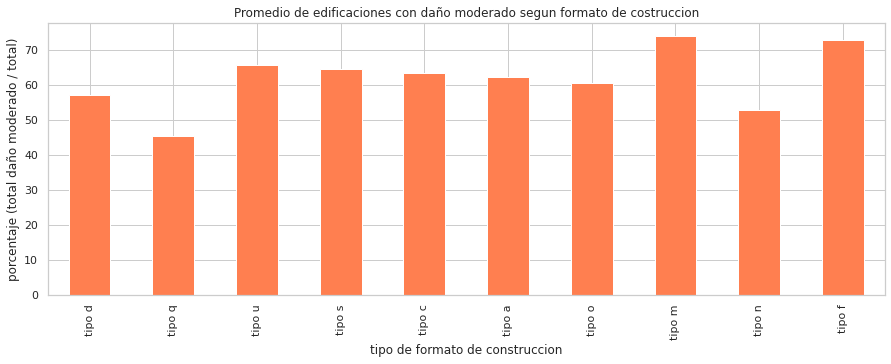

In [ ]:
promedio_danio_moderado_formato.plot(kind='bar',figsize=(15,5),title='Promedio de edificaciones con daño moderado segun formato de costruccion', color='coral',ylabel='porcentaje (total daño moderado / total)', xlabel='tipo de formato de construccion', legend=False )

In [ ]:
danio_leve_formato = danio_segun_formato_de_construccion.loc[danio_segun_formato_de_construccion['damage_grade']==3,['plan_configuration','total_edificaciones_con_formato']]

In [ ]:
danio_leve_formato.head()

,plan_configuration,total_edificaciones_con_formato
0,d,250072
2,d,250072
4,d,250072
6,d,250072
10,d,250072


In [ ]:
danio_leve_formato = danio_leve_formato.value_counts().to_frame().rename(columns={'plan_configuration':'tipo_formato',0:'cantidad_de_edificaciones'}).rename(index={'a':'tipo a','c':'tipo c','d':'tipo d','f':'tipo f','m':'tipo m','n':'tipo n','o':'tipo o','q':'tipo q','s':'tipo s','u':'tipo u'}).reset_index().set_index('plan_configuration')

In [ ]:
danio_leve_formato.head()

,total_edificaciones_con_formato,cantidad_de_edificaciones
plan_configuration,,
tipo d,250072,84239
tipo q,5692,2326
tipo u,3649,476
tipo s,346,70
tipo c,325,33


In [ ]:
promedio_danio_leve_formato = ((danio_leve_formato['cantidad_de_edificaciones']*100)/danio_leve_formato['total_edificaciones_con_formato']).to_frame()

In [ ]:
promedio_danio_leve_formato

,0
plan_configuration,
tipo d,33.69
tipo q,40.86
tipo u,13.04
tipo s,20.23
tipo c,10.15
tipo a,11.51
tipo o,14.47
tipo n,31.58
tipo f,27.27


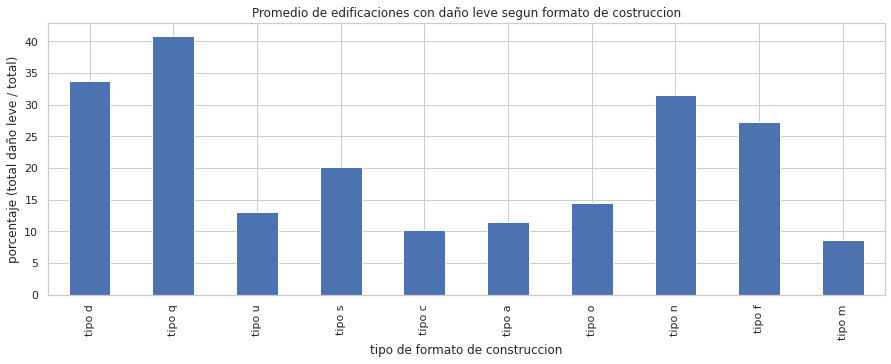

In [ ]:
promedio_danio_leve_formato.plot(kind='bar',figsize=(15,5),title='Promedio de edificaciones con daño leve segun formato de costruccion',ylabel='porcentaje (total daño leve / total)', xlabel='tipo de formato de construccion', legend=False )